# Libraries

In [12]:
# Basic
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.figure as fgr
import seaborn as sns
from scipy.stats import skew, shapiro, probplot
import matplotlib.gridspec as gridspec
import joblib


# Preprocessing
from sklearn.preprocessing import StandardScaler, LabelEncoder, OrdinalEncoder
from sklearn.model_selection import train_test_split, RepeatedKFold, KFold, cross_val_score, GridSearchCV, RandomizedSearchCV, RepeatedStratifiedKFold, StratifiedKFold

# Dimensionality Reduction
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import silhouette_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import adjusted_rand_score, homogeneity_score, normalized_mutual_info_score
import plotly.express as px


# Pipeline
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

# Models
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

# Error metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_squared_log_error, r2_score


# TensorFlow for Neural Networks
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, Callback
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam

# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")

# Dataset

In [2]:
train_df = pd.read_csv("/kaggle/input/corn-data/TASK-ML-INTERN.csv", index_col='hsi_id')

In [3]:
train_df.shape

(500, 449)

In [4]:
train_df.head()

,0,1,2,3,4,5,6,7,8,9,...,439,440,441,442,443,444,445,446,447,vomitoxin_ppb
hsi_id,,,,,,,,,,,,,,,,,,,,,
imagoai_corn_0,0.416181,0.396844,0.408985,0.372865,0.385293,0.365390,0.355226,0.343350,0.344837,0.361567,...,0.710280,0.717482,0.715078,0.705379,0.696691,0.692793,0.711369,0.697679,0.704520,1100.0
imagoai_corn_1,0.415797,0.402956,0.402564,0.396014,0.397192,0.389634,0.375671,0.363689,0.373883,0.359674,...,0.684011,0.697271,0.701995,0.696077,0.701012,0.677418,0.696921,0.696544,0.689054,1000.0
imagoai_corn_2,0.389023,0.371206,0.373098,0.373872,0.361056,0.349709,0.333882,0.330841,0.328925,0.323854,...,0.683054,0.669286,0.663179,0.676165,0.676591,0.655951,0.658945,0.670989,0.665176,1300.0
imagoai_corn_3,0.468837,0.473255,0.462949,0.459335,0.461672,0.459824,0.458194,0.427737,0.415360,0.413106,...,0.742782,0.730801,0.736787,0.730044,0.751437,0.738497,0.742446,0.754657,0.733474,1300.0
imagoai_corn_4,0.483352,0.487274,0.469153,0.487648,0.464026,0.451152,0.458229,0.440782,0.426193,0.430482,...,0.770227,0.773013,0.761431,0.763488,0.762473,0.744012,0.775486,0.760431,0.751988,220.0


In [5]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, imagoai_corn_0 to imagoai_corn_499
Columns: 449 entries, 0 to vomitoxin_ppb
dtypes: float64(449)
memory usage: 1.7+ MB


In [6]:
train_df.describe()

,0,1,2,3,4,5,6,7,8,9,...,439,440,441,442,443,444,445,446,447,vomitoxin_ppb
count,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,...,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,0.443118,0.440761,0.433814,0.426122,0.418990,0.412432,0.405868,0.399815,0.394038,0.389664,...,0.741255,0.740818,0.740459,0.739758,0.739850,0.738738,0.738298,0.737599,0.738099,3410.006000
std,0.044719,0.045520,0.045764,0.046070,0.045405,0.044727,0.044528,0.043773,0.043659,0.043442,...,0.053479,0.053695,0.053812,0.053666,0.053487,0.053601,0.054014,0.054136,0.054297,13095.803483
min,0.311182,0.295321,0.284064,0.282054,0.296702,0.286860,0.262876,0.278523,0.255529,0.261459,...,0.562662,0.585011,0.558412,0.571735,0.575259,0.571767,0.577803,0.576985,0.562302,0.000000
25%,0.410456,0.404310,0.397038,0.389029,0.382102,0.377157,0.369620,0.364823,0.360634,0.355246,...,0.702105,0.703701,0.702988,0.700889,0.701690,0.700638,0.698655,0.698107,0.699673,137.500000
50%,0.449105,0.442651,0.434215,0.425074,0.417075,0.411872,0.405443,0.397917,0.393803,0.387211,...,0.743857,0.745922,0.745062,0.743991,0.744004,0.743965,0.743301,0.745216,0.745733,500.000000
75%,0.480245,0.478822,0.473158,0.464947,0.459232,0.452198,0.444384,0.438728,0.431165,0.427039,...,0.777884,0.776210,0.777069,0.774759,0.775698,0.775686,0.775621,0.774635,0.774310,1700.000000
max,0.556287,0.530168,0.528774,0.533202,0.511909,0.501786,0.504054,0.490692,0.489272,0.472080,...,0.940642,0.940361,0.939153,0.930366,0.942615,0.945225,0.932812,0.931381,0.957860,131000.000000


# Preprocessing

## Null Values

In [7]:
for col in train_df.columns:
    print(col, " : ", train_df[col].isnull().sum())

0  :  0
1  :  0
2  :  0
3  :  0
4  :  0
5  :  0
6  :  0
7  :  0
8  :  0
9  :  0
10  :  0
11  :  0
12  :  0
13  :  0
14  :  0
15  :  0
16  :  0
17  :  0
18  :  0
19  :  0
20  :  0
21  :  0
22  :  0
23  :  0
24  :  0
25  :  0
26  :  0
27  :  0
28  :  0
29  :  0
30  :  0
31  :  0
32  :  0
33  :  0
34  :  0
35  :  0
36  :  0
37  :  0
38  :  0
39  :  0
40  :  0
41  :  0
42  :  0
43  :  0
44  :  0
45  :  0
46  :  0
47  :  0
48  :  0
49  :  0
50  :  0
51  :  0
52  :  0
53  :  0
54  :  0
55  :  0
56  :  0
57  :  0
58  :  0
59  :  0
60  :  0
61  :  0
62  :  0
63  :  0
64  :  0
65  :  0
66  :  0
67  :  0
68  :  0
69  :  0
70  :  0
71  :  0
72  :  0
73  :  0
74  :  0
75  :  0
76  :  0
77  :  0
78  :  0
79  :  0
80  :  0
81  :  0
82  :  0
83  :  0
84  :  0
85  :  0
86  :  0
87  :  0
88  :  0
89  :  0
90  :  0
91  :  0
92  :  0
93  :  0
94  :  0
95  :  0
96  :  0
97  :  0
98  :  0
99  :  0
100  :  0
101  :  0
102  :  0
103  :  0
104  :  0
105  :  0
106  :  0
107  :  0
108  :  0
109  :  0
110  :  0


## Duplicate rows

In [8]:
duplicate_count = train_df.duplicated().sum()
print(f"\nNumber of duplicate rows: {duplicate_count}")


Number of duplicate rows: 0


# EDA

## Univariate Analysis

In [9]:
# Function to calculate skewness and test normality
def analyze_distribution(df, col):
    """
    Analyzes the skewness and normality of a column in a DataFrame.
    Returns skewness value and Shapiro test results.
    """
    skewness = skew(df[col].dropna())
    stat, p_value = shapiro(df[col].dropna())
    
    return {
        'column': col,
        'skewness': skewness,
        'shapiro_stat': stat,
        'shapiro_p_value': p_value
    }

# Updated distribution plot with skewness and normality info
def my_distplot_with_stats(df, col, ax):
    sns.histplot(df[col].dropna(), kde=True, ax=ax, color='skyblue')
    ax.set_title(f'Distribution of {col}')
    
    stats = analyze_distribution(df, col)
    skewness_text = f"Skewness: {stats['skewness']:.2f}"
    normality_text = f"Shapiro p-value: {stats['shapiro_p_value']:.4f}"
    ax.text(0.05, 0.95, skewness_text + '\n' + normality_text,
            transform=ax.transAxes, fontsize=10, verticalalignment='top')

# Q-Q plot to visually assess normality
def my_qqplot(df, col, ax):
    probplot(df[col].dropna(), dist="norm", plot=ax)
    ax.set_title(f'Q-Q Plot of {col}')

# Analyze and plot distribution for all spectral features
def analyze_and_plot_distribution(df, size=(12, 4), n_col=2, exclude_cols=['vomitoxin_ppb']):
    # Filter numeric columns excluding the target
    numeric_cols = [col for col in df.select_dtypes(include=[np.number]).columns if col not in exclude_cols]
    if len(numeric_cols) == 0:
        print("No numeric columns found (excluding excluded columns).")
        return
    
    # Analyze skewness and normality
    results = [analyze_distribution(df, col) for col in numeric_cols]
    results_df = pd.DataFrame(results)
    
    print("\nSkewness and Normality Analysis (Excluding Target Column 'vomitoxin_ppb'):")
    print("-" * 60)
    print(results_df.to_string(index=False))
    print("-" * 60)
    print("Interpretation:")
    print("✔ Skewness: < -1 or > 1 (highly skewed), -1 to -0.5 or 0.5 to 1 (moderate), -0.5 to 0.5 (symmetric)")
    print("✔ Shapiro p-value: > 0.05 (normal), <= 0.05 (not normal)")
    
    # Plot distributions
    n_rows = (len(numeric_cols) + n_col - 1) // n_col
    fig, axes = plt.subplots(n_rows, n_col, figsize=(size[0] * n_col, size[1] * n_rows))
    axes = np.array(axes).flatten() if n_rows > 1 or n_col > 1 else [axes]
    
    for i, col in enumerate(numeric_cols):
        my_distplot_with_stats(df, col, axes[i])
    
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Plot Q-Q plots
    fig, axes = plt.subplots(n_rows, n_col, figsize=(size[0] * n_col, size[1] * n_rows))
    axes = np.array(axes).flatten() if n_rows > 1 or n_col > 1 else [axes]
    
    for i, col in enumerate(numeric_cols):
        my_qqplot(df, col, axes[i])
    
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

# ✅ Example usage:
analyze_and_plot_distribution(train_df, size=(6, 3), n_col=3)



Skewness and Normality Analysis (Excluding Target Column 'vomitoxin_ppb'):
------------------------------------------------------------
column  skewness  shapiro_stat  shapiro_p_value
     0 -0.328661      0.978002     7.502051e-07
     1 -0.265150      0.977323     5.190812e-07
     2 -0.246360      0.973738     8.153863e-08
     3 -0.167942      0.975340     1.830403e-07
     4 -0.159769      0.974978     1.520848e-07
     5 -0.154820      0.974304     1.081622e-07
     6 -0.143112      0.977332     5.215088e-07
     7 -0.137166      0.973662     7.854832e-08
     8 -0.200462      0.978973     1.283790e-06
     9 -0.185764      0.973396     6.886520e-08
    10 -0.153922      0.976554     3.443616e-07
    11 -0.164147      0.978942     1.261686e-06
    12 -0.150890      0.978163     8.194241e-07
    13 -0.143516      0.982992     1.377759e-05
    14 -0.228424      0.983594     2.010877e-05
    15 -0.213916      0.988655     6.423565e-04
    16 -0.166226      0.990263     2.171676e-03


📌 Descriptive Statistics for 'vomitoxin_ppb':
--------------------------------------------------
count       500.000000
mean       3410.006000
std       13095.803483
min           0.000000
25%         137.500000
50%         500.000000
75%        1700.000000
max      131000.000000
Name: vomitoxin_ppb, dtype: float64

Skewness: 7.2035
Shapiro-Wilk Test → Statistic: 0.2372, p-value: 0.0000
Interpretation:
⚠️ Data is likely not normally distributed (reject H0).


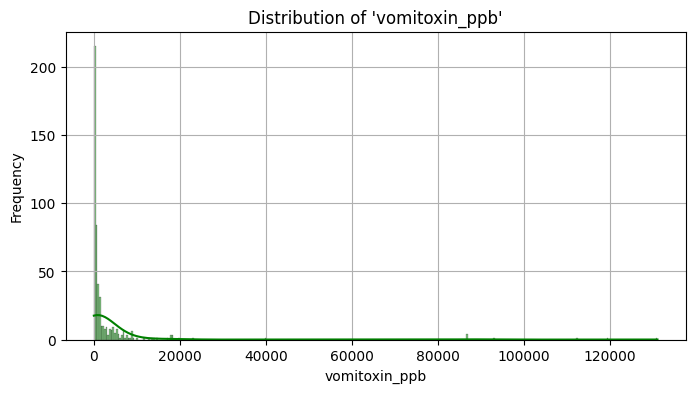

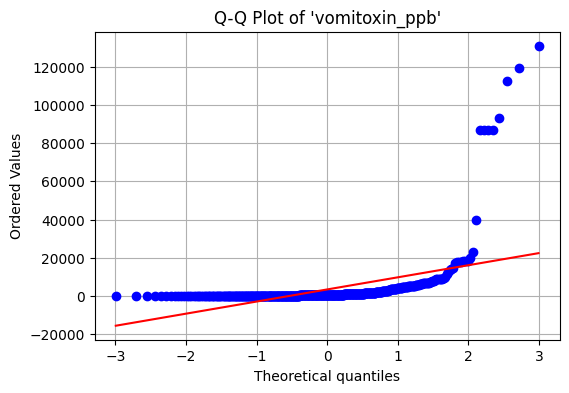

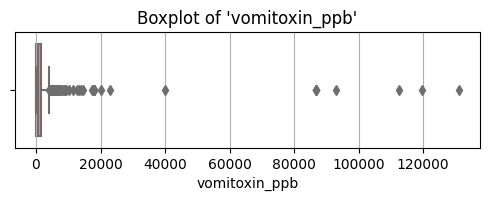

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import skew, shapiro, probplot

def analyze_target_column(df, target_col='vomitoxin_ppb'):
    data = df[target_col].dropna()

    print(f"\n📌 Descriptive Statistics for '{target_col}':")
    print("-" * 50)
    print(data.describe())
    print(f"\nSkewness: {skew(data):.4f}")
    
    stat, p_value = shapiro(data)
    print(f"Shapiro-Wilk Test → Statistic: {stat:.4f}, p-value: {p_value:.4f}")
    print("Interpretation:")
    if p_value > 0.05:
        print("✅ Data appears normally distributed (fail to reject H0).")
    else:
        print("⚠️ Data is likely not normally distributed (reject H0).")

    # Plot: Distribution with KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(data, kde=True, color='green')
    plt.title(f"Distribution of '{target_col}'")
    plt.xlabel(target_col)
    plt.ylabel("Frequency")
    plt.grid(True)
    plt.show()

    # Plot: Q-Q Plot
    plt.figure(figsize=(6, 4))
    probplot(data, dist="norm", plot=plt)
    plt.title(f"Q-Q Plot of '{target_col}'")
    plt.grid(True)
    plt.show()

    # Plot: Boxplot (outlier detection)
    plt.figure(figsize=(6, 1.5))
    sns.boxplot(x=data, color='lightcoral')
    plt.title(f"Boxplot of '{target_col}'")
    plt.grid(True, axis='x')
    plt.show()

# ✅ Run the function
analyze_target_column(train_df, target_col='vomitoxin_ppb')


## Multivariate Analysis


🔍 Top 5 correlated spectral bands with 'vomitoxin_ppb':
--------------------------------------------------
140   -0.313444
135   -0.307941
127   -0.303796
143   -0.302372
149   -0.300649
Name: vomitoxin_ppb, dtype: float64


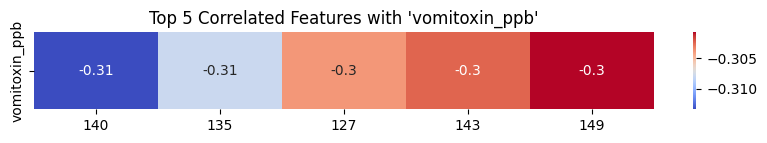


📊 Regression Plots for Top 5 Features vs 'vomitoxin_ppb'


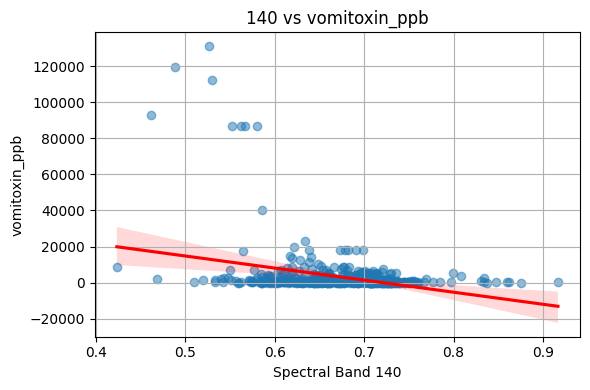

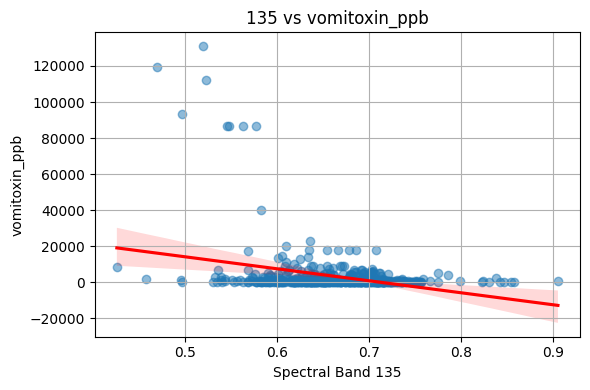

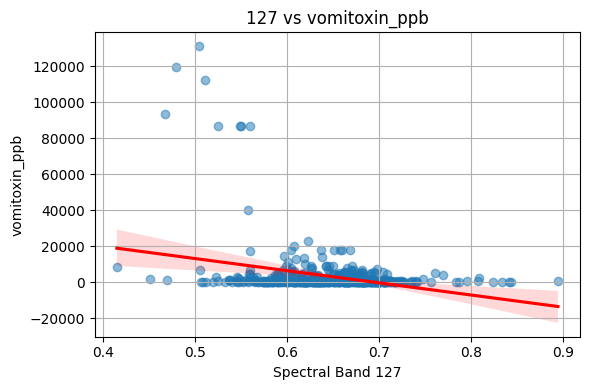

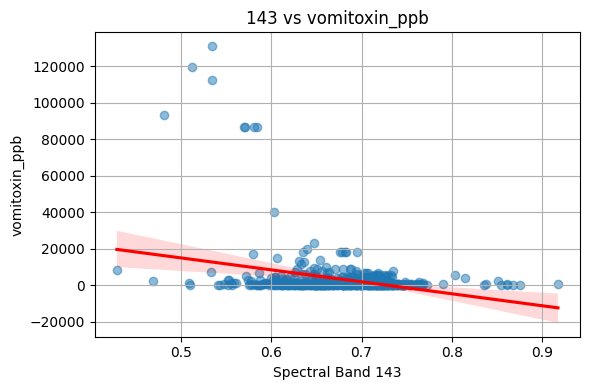

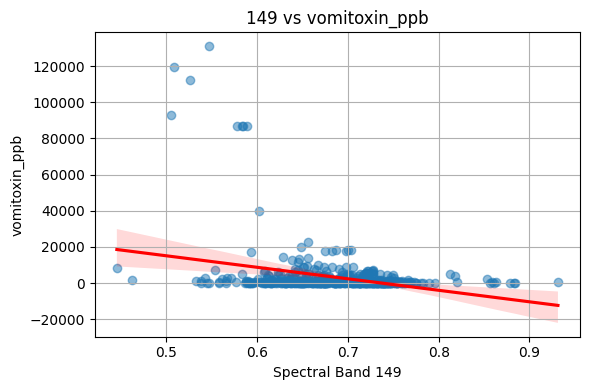

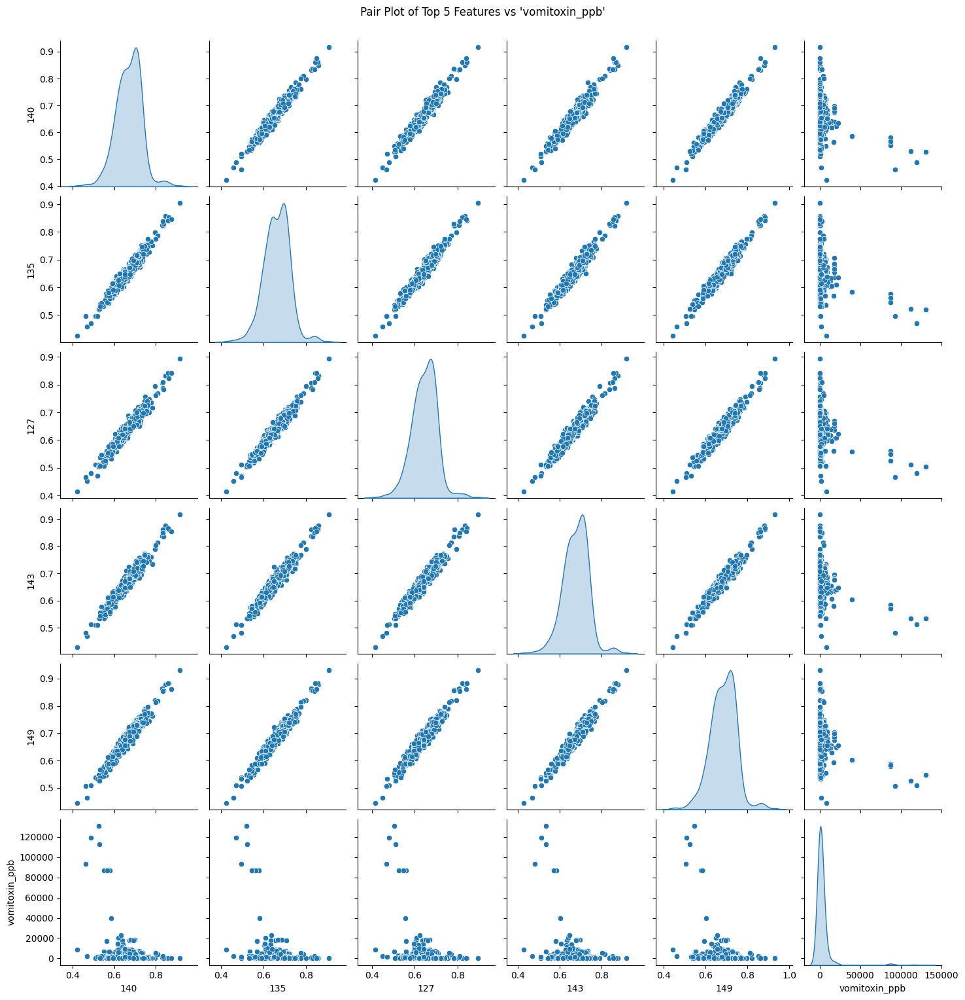

In [10]:
def multivariate_analysis(df, target_col='vomitoxin_ppb', top_n=5):
    # Step 1: Compute correlation with the target
    correlations = df.corr()[target_col].drop(target_col).sort_values(key=abs, ascending=False)
    
    print(f"\n🔍 Top {top_n} correlated spectral bands with '{target_col}':")
    print("-" * 50)
    print(correlations.head(top_n))

    # Step 2: Plot correlation heatmap (top N)
    plt.figure(figsize=(10, 1))
    sns.heatmap(correlations.head(top_n).to_frame().T, annot=True, cmap='coolwarm')
    plt.title(f"Top {top_n} Correlated Features with '{target_col}'")
    plt.show()

    # Step 3: Regression scatter plots for top N features
    top_features = correlations.head(top_n).index.tolist()

    print(f"\n📊 Regression Plots for Top {top_n} Features vs '{target_col}'")
    for feature in top_features:
        plt.figure(figsize=(6, 4))
        sns.regplot(x=df[feature], y=df[target_col], scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
        plt.title(f"{feature} vs {target_col}")
        plt.xlabel(f"Spectral Band {feature}")
        plt.ylabel(target_col)
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    # Step 4: Pair Plot for Top N Features
    if len(top_features) > 1:
        sns.pairplot(df[top_features + [target_col]], diag_kind='kde')
        plt.suptitle(f"Pair Plot of Top {top_n} Features vs '{target_col}'", y=1.02)
        plt.show()

# ✅ Run it on your dataset
multivariate_analysis(train_df, target_col='vomitoxin_ppb', top_n=5)

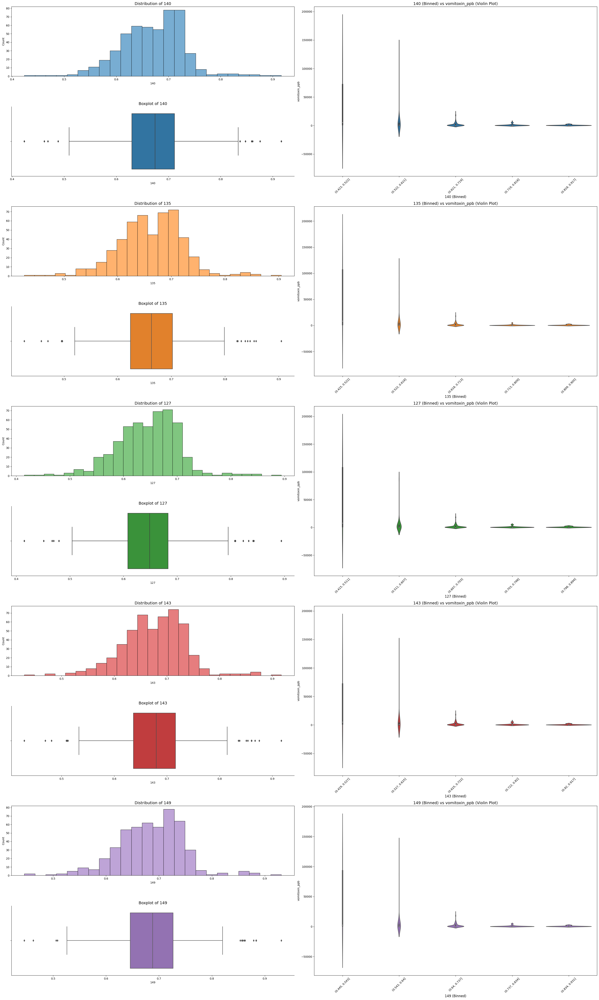

In [16]:
def multivariate_feature_analysis(df, target_column='vomitoxin_ppb', top_k=5, bin_size=10):
    df = df.copy()

    # Select top_k features most correlated with the target
    selected_columns = df.drop(columns=[target_column]).corrwith(df[target_column])\
                         .abs().sort_values(ascending=False).head(top_k).index.tolist()

    # Create color palette
    palette = sns.color_palette('tab10', len(selected_columns))
    color_dict = dict(zip(selected_columns, palette))

    # Set up figure
    fig = plt.figure(figsize=(30, 10 * len(selected_columns)))
    gs = gridspec.GridSpec(2 * len(selected_columns), 2, figure=fig)

    df_binned = df.copy()

    for i, column in enumerate(selected_columns):
        # Decide whether to use discrete mode for histogram
        discrete = df[column].nunique() <= 50

        # Histogram
        ax_hist = fig.add_subplot(gs[2 * i, 0])
        sns.histplot(
            data=df, x=column, fill=True, common_norm=False, alpha=0.6,
            linewidth=0.8, color=color_dict[column], ax=ax_hist, discrete=discrete
        )
        ax_hist.set_title(f'Distribution of {column}', fontsize=14)

        # Boxplot
        ax_box = fig.add_subplot(gs[2 * i + 1, 0])
        sns.boxplot(data=df, x=column, ax=ax_box, color=color_dict[column])
        ax_box.set_title(f'Boxplot of {column}', fontsize=14)
        sns.despine(ax=ax_box)

        # Violin Plot with binning
        ax_violin = fig.add_subplot(gs[2 * i:2 * i + 2, 1])
        df_binned['Binned'] = pd.cut(df[column], bins=bin_size)
        sns.violinplot(
            data=df_binned, x='Binned', y=target_column, ax=ax_violin,
            color=color_dict[column], alpha=0.6
        )
        ax_violin.set_title(f'{column} (Binned) vs {target_column} (Violin Plot)', fontsize=14)
        ax_violin.set_xlabel(f'{column} (Binned)', fontsize=12)
        plt.setp(ax_violin.get_xticklabels(), rotation=45)

    plt.tight_layout()
    plt.show()

# Example usage
multivariate_feature_analysis(train_df, target_column='vomitoxin_ppb', top_k=5, bin_size=5)

# Dimension Reduction

## PCA

In [3]:
def run_pca_analysis_with_visualization(df, target_column='vomitoxin_ppb', n_components=100):
    # Step 1: Select numerical features (excluding target)
    features = df.drop(columns=[target_column])
    numeric_features = features.select_dtypes(include=np.number)

    # Step 2: Standardize features
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_features)

    # Step 3: Apply PCA
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(scaled_data)

    # Step 4: Explained Variance Ratio (Scree plot)
    explained_var = pca.explained_variance_ratio_
    cum_var = np.cumsum(explained_var)

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, n_components + 1), cum_var, marker='o', linestyle='--', color='b')
    plt.title('Cumulative Explained Variance by Principal Components')
    plt.xlabel('Number of Principal Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.grid(True)
    plt.axhline(y=0.90, color='r', linestyle='--', label='90% Variance Threshold')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Step 5: Create a DataFrame for PCs
    pca_df = pd.DataFrame(data=principal_components,
                          columns=[f'PC{i+1}' for i in range(n_components)])
    pca_df[target_column] = df[target_column].values

    # Step 6: 2D scatter of PC1 vs PC2
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(pca_df['PC1'], pca_df['PC2'], c=pca_df[target_column], cmap='viridis', s=40)
    plt.colorbar(scatter, label=target_column)
    plt.title('PCA - PC1 vs PC2 colored by target')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.tight_layout()
    plt.show()

    # Step 7: 3D scatter of PC1, PC2, and PC3
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    p = ax.scatter(pca_df['PC1'], pca_df['PC2'], pca_df['PC3'], c=pca_df[target_column], cmap='coolwarm', s=30)
    fig.colorbar(p, label=target_column)
    ax.set_title('PCA 3D: PC1 vs PC2 vs PC3')
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    plt.tight_layout()
    plt.show()

    # Step 8: Correlation of original features with principal components
    pc_components = pd.DataFrame(pca.components_.T,
                                 columns=[f'PC{i+1}' for i in range(n_components)],
                                 index=numeric_features.columns)

    plt.figure(figsize=(12, min(0.4 * len(numeric_features.columns), 12)))
    sns.heatmap(pc_components, annot=False, cmap='coolwarm', center=0)
    plt.title('Feature Contribution to Principal Components')
    plt.tight_layout()
    plt.show()

    # Step 9: Variance threshold suggestion
    components_to_keep = np.argmax(cum_var >= 0.90) + 1
    print(f"✅ To retain 90% of the variance, you can keep top {components_to_keep} principal components.")
    print(f"➡️ This suggests you can reduce dimensionality from {scaled_data.shape[1]} to {components_to_keep}.")

    return pca_df, pc_components, explained_var, scaler, scaled_data

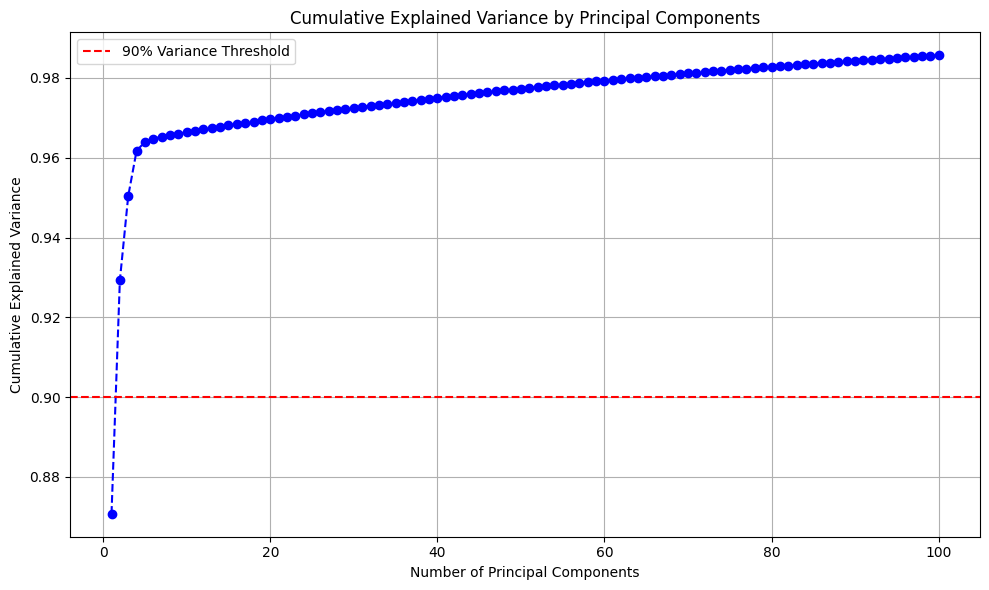

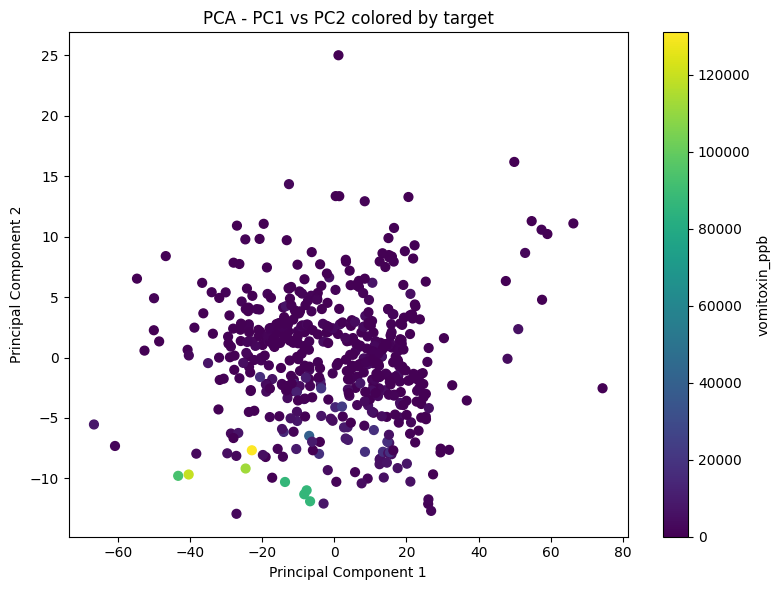

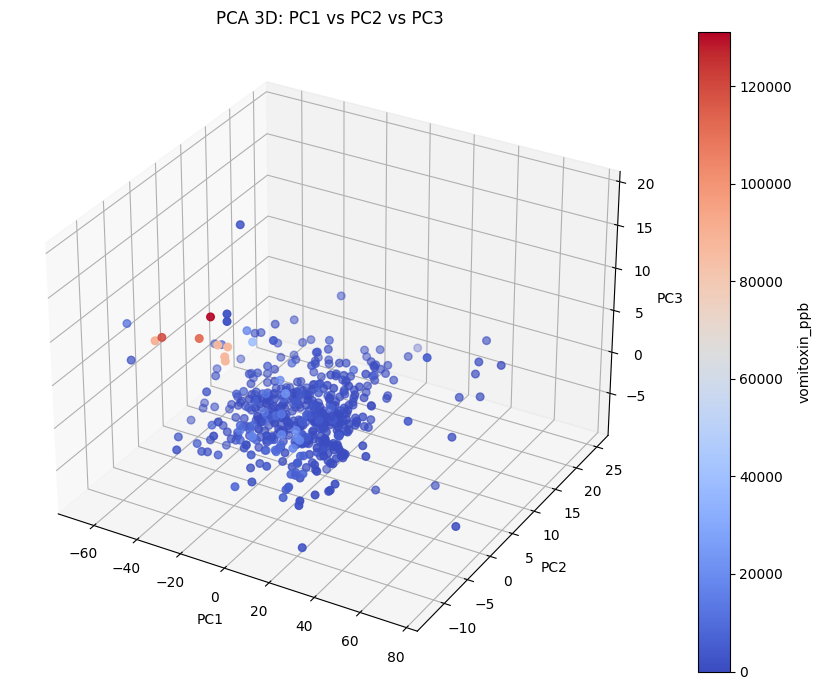

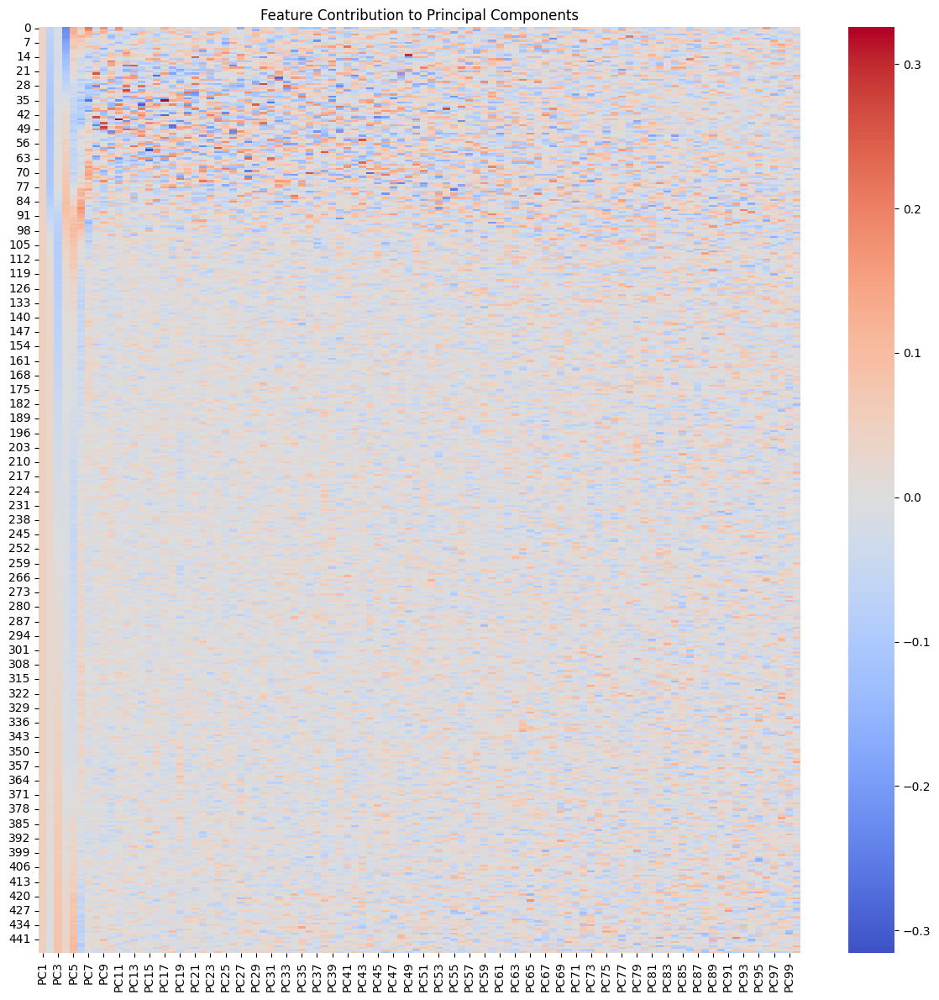

✅ To retain 90% of the variance, you can keep top 2 principal components.
➡️ This suggests you can reduce dimensionality from 448 to 2.


In [4]:
pca_result, pc_contributions, explained_var, scaler, scaled_data = run_pca_analysis_with_visualization(train_df, target_column='vomitoxin_ppb', n_components=100)

## K-means on PCA

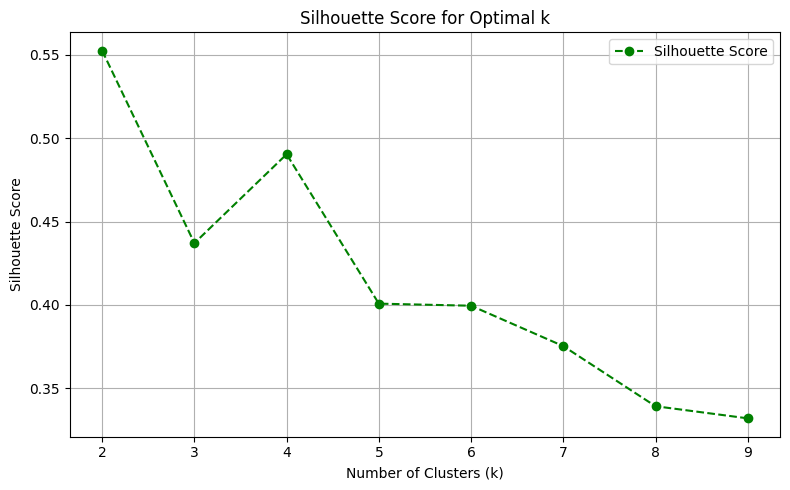

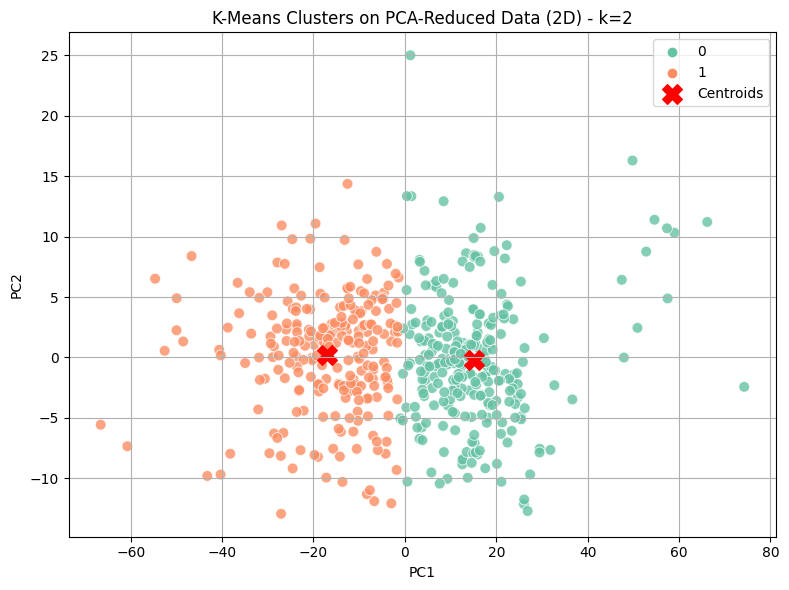

🔍 Silhouette Score for 2 clusters: 0.5525


In [51]:
def run_kmeans_on_pca(df, target_column='vomitoxin_ppb', n_clusters=None, show_silhouette_plot=True):
    features = df.drop(columns=[target_column])
    numeric_features = features.select_dtypes(include=np.number)

    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_features)

    pca = PCA(n_components=2)
    pca_data = pca.fit_transform(scaled_data)
    pca_df = pd.DataFrame(pca_data, columns=['PC1', 'PC2'])

    if show_silhouette_plot:
        silhouette_scores = []
        k_range = range(2, 10)
        for k in k_range:
            km = KMeans(n_clusters=k, random_state=42)
            cluster_labels = km.fit_predict(pca_df)
            score = silhouette_score(pca_df, cluster_labels)
            silhouette_scores.append(score)

        best_k = k_range[np.argmax(silhouette_scores)]
        best_score = max(silhouette_scores)

        plt.figure(figsize=(8, 5))
        plt.plot(k_range, silhouette_scores, 'go--', marker='o', label='Silhouette Score')
        plt.xlabel('Number of Clusters (k)')
        plt.ylabel('Silhouette Score')
        plt.title('Silhouette Score for Optimal k')
        plt.xticks(k_range)  # Show all k values on the x-axis
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

        if n_clusters is None:
            n_clusters = best_k

    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(pca_df)
    pca_df['Cluster'] = cluster_labels
    pca_df[target_column] = df[target_column].values

    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='Set2', s=60, alpha=0.8)
    plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
                c='red', marker='X', s=200, label='Centroids')
    plt.title(f'K-Means Clusters on PCA-Reduced Data (2D) - k={n_clusters}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    silhouette = silhouette_score(pca_df[['PC1', 'PC2']], cluster_labels)
    print(f"🔍 Silhouette Score for {n_clusters} clusters: {silhouette:.4f}")

    return pca_df, kmeans

clustered_df, kmeans_model = run_kmeans_on_pca(train_df, target_column='vomitoxin_ppb', n_clusters=None)

# Splitting

## Without PCA

In [3]:
# Step 1: Separate features and target
X = train_df.drop(columns=['vomitoxin_ppb'])  # features
y = train_df['vomitoxin_ppb']                # target

# Step 2: Split data - First into 80% train, 20% temp
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Step 3: Split remaining 20% equally into 10% val and 10% test
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, random_state=42
)

# Step 4: Apply StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled   = scaler.transform(X_val)
X_test_scaled  = scaler.transform(X_test)

# Optional: Convert to DataFrame for easier readability
X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=X.columns)
X_val_scaled_df   = pd.DataFrame(X_val_scaled, columns=X.columns)
X_test_scaled_df  = pd.DataFrame(X_test_scaled, columns=X.columns)

# Step 5: Show dataset shapes and head
print("✅ Split Complete:")
print(f"Training set shape:     {X_train_scaled_df.shape}")
print(f"Validation set shape:   {X_val_scaled_df.shape}")
print(f"Test set shape:         {X_test_scaled_df.shape}")


✅ Split Complete:
Training set shape:     (400, 448)
Validation set shape:   (50, 448)
Test set shape:         (50, 448)


## With PCA

In [5]:
# Step 1: Separate features and target
X = train_df.drop(columns=['vomitoxin_ppb'])  # Use original features
y = train_df['vomitoxin_ppb']

# Step 2: Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 3: Apply PCA (with 10 components)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Convert to DataFrame (with PC1 through PC2)
pca_columns = [f'PC{i+1}' for i in range(2)]
X_pca_df = pd.DataFrame(X_pca, columns=pca_columns)

# Step 4: Split PCA-transformed data into 80:10:10
X_train_pca, X_temp_pca, y_train, y_temp = train_test_split(
    X_pca_df, y, test_size=0.2, random_state=42
)

X_val_pca, X_test_pca, y_val, y_test = train_test_split(
    X_temp_pca, y_temp, test_size=0.5, random_state=42
)

# Step 5: Show results
print("✅ PCA + Split Complete:")
print(f"Training set shape:     {X_train_pca.shape}")
print(f"Validation set shape:   {X_val_pca.shape}")
print(f"Test set shape:         {X_test_pca.shape}")


✅ PCA + Split Complete:
Training set shape:     (400, 2)
Validation set shape:   (50, 2)
Test set shape:         (50, 2)


# Models Training with and without PCA

## LR, RF, XgBoost, LGBM

In [13]:
# Define a function to save model results
def save_model_results(model_name, model, results, is_pca):
    joblib.dump(model, f'best_{model_name}_model{"_pca" if is_pca else ""}.pkl')
    results_df = pd.DataFrame(results)  # Convert results to DataFrame
    results_df.to_csv(f'{model_name}_results{"_pca" if is_pca else ""}.csv', index=False)

# Define a function to evaluate models
def evaluate_model(model, X_val, y_val, X_test, y_test):
    val_preds = model.predict(X_val)
    test_preds = model.predict(X_test)
    
    val_results = {
        "MAE": mean_absolute_error(y_val, val_preds),
        "MSE": mean_squared_error(y_val, val_preds),
        "R2": r2_score(y_val, val_preds)
    }

    test_results = {
        "MAE": mean_absolute_error(y_test, test_preds),
        "MSE": mean_squared_error(y_test, test_preds),
        "R2": r2_score(y_test, test_preds)
    }
    
    return val_results, test_results

# Define Random Forest parameters
rf_params = {
    'n_estimators': [200, 500],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'max_features': ['sqrt'],
    'bootstrap': [True],
    'random_state': [42]
}

# Define XGBoost parameters
xgb_params = {
    'lambda': [0.01],
    'alpha': [0.01],
    'colsample_bytree': [0.3],
    'subsample': [0.6],
    'learning_rate': [0.01],
    'max_depth': [10],
    'min_child_weight': [1],
}

# Define LightGBM parameters
lgbm_params = {
    'num_leaves': [64],
    'max_depth': [10],
    'learning_rate': [0.005],
    'subsample': [0.5],
    'colsample_bytree': [0.7],
    'reg_alpha': [1e-6],
    'reg_lambda': [0.01],
    'min_data_in_leaf': [30],
    'feature_fraction': [0.6],
    'bagging_fraction': [0.4],
    'min_child_weight': [0.01],
    'cat_smooth': [20],
}

# K-Fold Cross Validation
kf = KFold(n_splits=3, shuffle=True, random_state=42)

# Function to train and evaluate models
def train_and_evaluate_model(model_name, model, params, X_train, y_train, X_val, y_val, X_test, y_test, is_pca=False):
    grid_search = GridSearchCV(model, param_grid=params, cv=kf, n_jobs=-1)
    print(f"📌 Fitting {model_name} {'with PCA' if is_pca else 'without PCA'}...")
    grid_search.fit(X_train, y_train)

    # Save the best model
    best_model = grid_search.best_estimator_
    save_model_results(model_name, best_model, grid_search.cv_results_, is_pca)

    # Evaluate the model
    val_results, test_results = evaluate_model(best_model, X_val, y_val, X_test, y_test)

    print(f"\n📊 {model_name} {'with PCA' if is_pca else 'without PCA'} (Validation):")
    print(val_results)

    print(f"\n📊 {model_name} {'with PCA' if is_pca else 'without PCA'} (Test):")
    print(test_results)


# --- Train and evaluate Linear Regression ---
train_and_evaluate_model("LinearRegression", LinearRegression(), {}, 
                         X_train_scaled_df, y_train, X_val_scaled_df, y_val, X_test_scaled_df, y_test, is_pca=False)
train_and_evaluate_model("LinearRegression", LinearRegression(), {}, 
                         X_train_pca, y_train, X_val_pca, y_val, X_test_pca, y_test, is_pca=True)

# Train and evaluate Random Forest
train_and_evaluate_model("Random Forest", RandomForestRegressor(), rf_params, X_train_scaled_df, y_train, X_val_scaled_df, y_val, X_test_scaled_df, y_test, is_pca=False)
train_and_evaluate_model("Random Forest", RandomForestRegressor(), rf_params, X_train_pca, y_train, X_val_pca, y_val, X_test_pca, y_test, is_pca=True)

# Train and evaluate XGBoost
train_and_evaluate_model("XGBoost", XGBRegressor(random_state=42, tree_method='hist'), xgb_params, X_train_scaled_df, y_train, X_val_scaled_df, y_val, X_test_scaled_df, y_test, is_pca=False)
train_and_evaluate_model("XGBoost", XGBRegressor(random_state=42, tree_method='hist'), xgb_params, X_train_pca, y_train, X_val_pca, y_val, X_test_pca, y_test, is_pca=True)

# Train and evaluate LightGBM
train_and_evaluate_model("LightGBM", LGBMRegressor(random_state=42), lgbm_params, X_train_scaled_df, y_train, X_val_scaled_df, y_val, X_test_scaled_df, y_test, is_pca=False)
train_and_evaluate_model("LightGBM", LGBMRegressor(random_state=42), lgbm_params, X_train_pca, y_train, X_val_pca, y_val, X_test_pca, y_test, is_pca=True)

# Comparative Analysis
results = {
    "Model": [],
    "PCA": [],
    "MAE": [],
    "MSE": [],
    "R2": []
}

# Load results from saved CSV files
for model in ["Random Forest", "XGBoost", "LightGBM", "LinearRegression"]:
    for pca in [False, True]:
        file_name = f'{model}_results{"_pca" if pca else ""}.csv'
        if os.path.exists(file_name):
            df = pd.read_csv(file_name)
            if 'mean_test_score' in df.columns:
                best_index = df['mean_test_score'].idxmax()
                best_score = df.loc[best_index, 'mean_test_score']
            else:
                # Fallback if mean_test_score is not available
                best_score = df.iloc[0].get('MAE', None)

            results["Model"].append(model)
            results["PCA"].append(pca)
            results["MAE"].append(best_score)
            results["MSE"].append(best_score)  # Placeholder — replace with actual if available
            results["R2"].append(best_score)   # Placeholder — replace with actual if available
        else:
            print(f"⚠️ File not found: {file_name}")

results_df = pd.DataFrame(results)

# Display the results table
print("📊 Comparative Analysis Results:")
print(results_df)


📌 Fitting LinearRegression without PCA...

📊 LinearRegression without PCA (Validation):
{'MAE': 24083.785295916143, 'MSE': 902964456.2974789, 'R2': -4.85168843735043}

📊 LinearRegression without PCA (Test):
{'MAE': 28947.368736342705, 'MSE': 1268644965.681971, 'R2': -2.1420735656959877}
📌 Fitting LinearRegression with PCA...

📊 LinearRegression with PCA (Validation):
{'MAE': 4787.789971580021, 'MSE': 129112707.77308476, 'R2': 0.16328119681616926}

📊 LinearRegression with PCA (Test):
{'MAE': 6856.722999272029, 'MSE': 346814086.27571243, 'R2': 0.14103992671256316}
📌 Fitting Random Forest without PCA...

📊 Random Forest without PCA (Validation):
{'MAE': 2580.820941638274, 'MSE': 54815279.16342974, 'R2': 0.644767927426477}

📊 Random Forest without PCA (Test):
{'MAE': 4679.764739372062, 'MSE': 173384554.73383212, 'R2': 0.5705756607513213}
📌 Fitting Random Forest with PCA...

📊 Random Forest with PCA (Validation):
{'MAE': 2362.6389279797977, 'MSE': 16507711.228113633, 'R2': 0.893021278692670

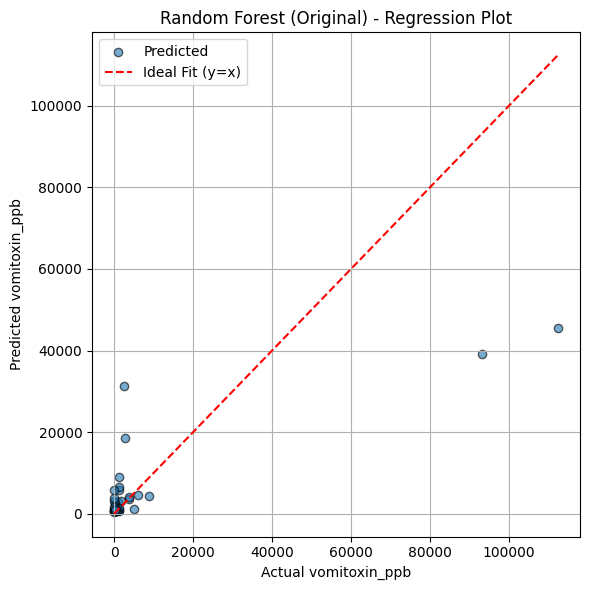

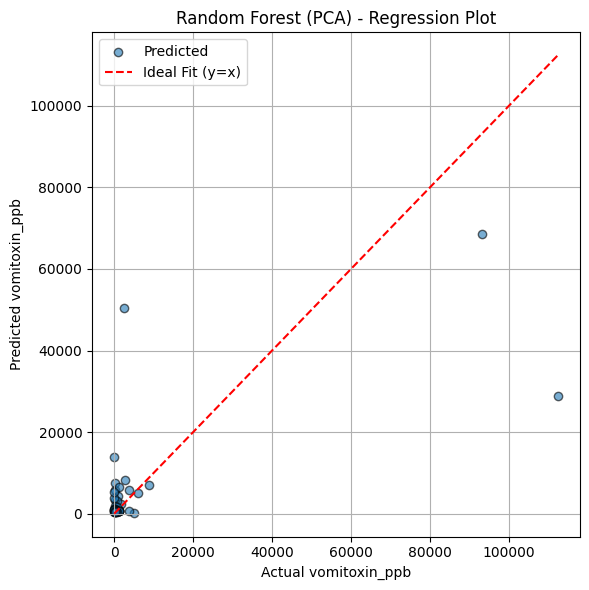

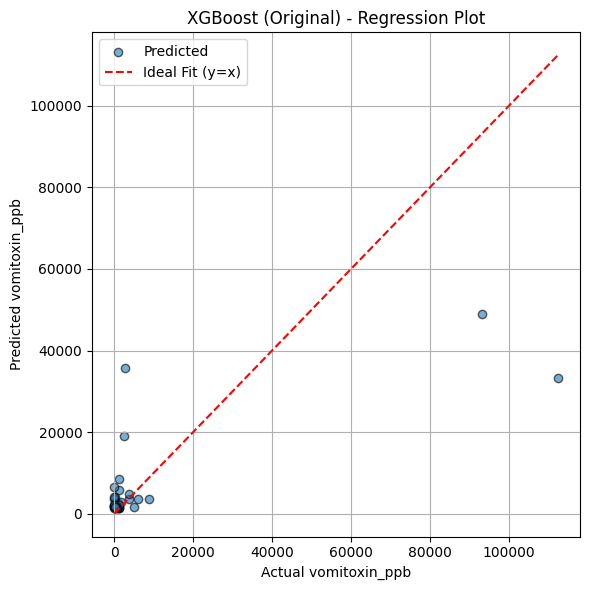

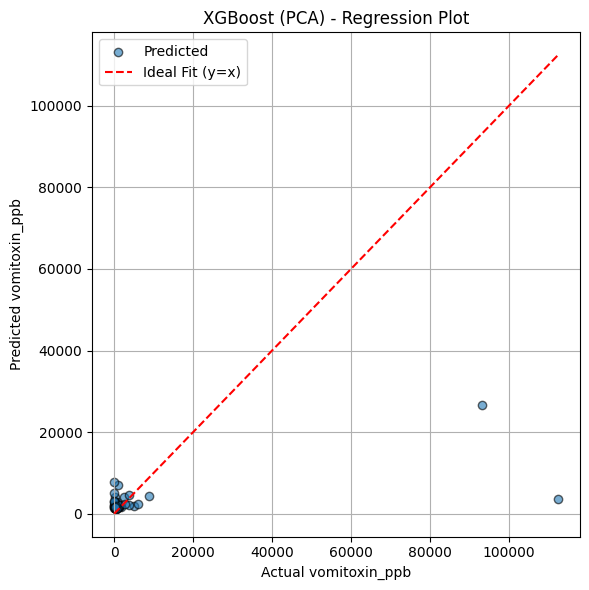

[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.6, colsample_bytree=0.7 will be ignored. Current value: feature_fraction=0.6
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=0.5 will be ignored. Current value: bagging_fraction=0.4


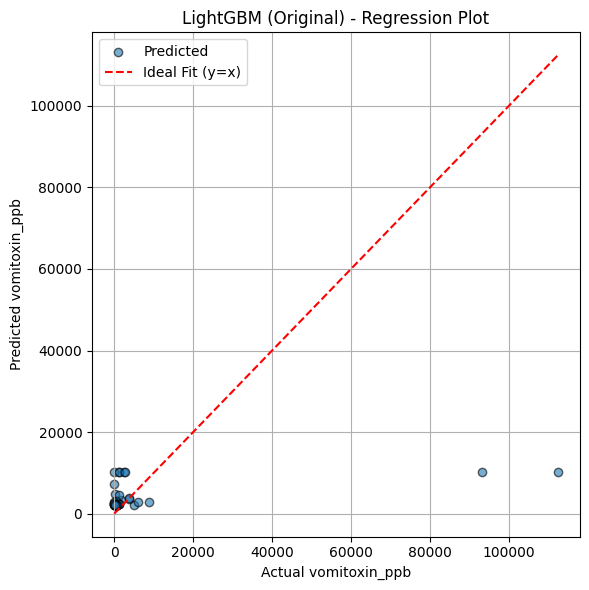

[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] feature_fraction is set=0.6, colsample_bytree=0.7 will be ignored. Current value: feature_fraction=0.6
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=0.5 will be ignored. Current value: bagging_fraction=0.4


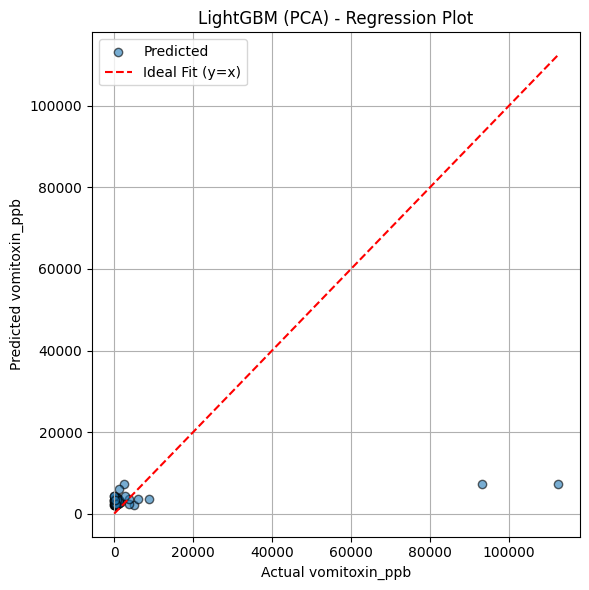

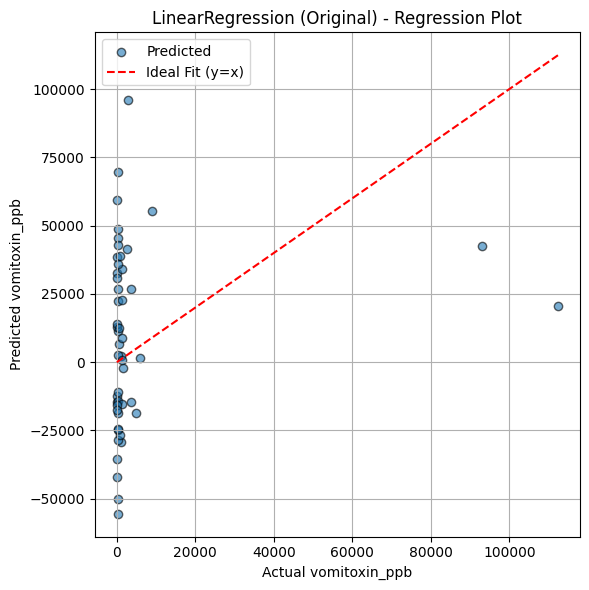

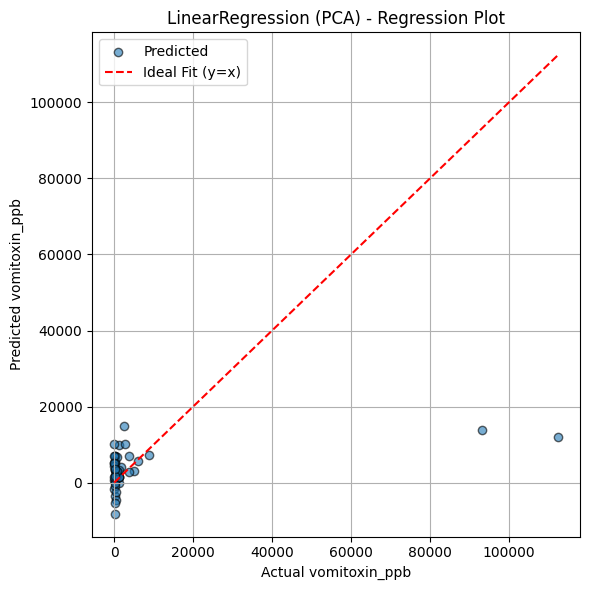

In [10]:
def plot_regression_results(model_name, model, X_test, y_test, is_pca=False):
    predictions = model.predict(X_test)
    
    plt.figure(figsize=(6, 6))
    plt.scatter(y_test, predictions, edgecolor='k', alpha=0.6, label='Predicted')
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--r', label='Ideal Fit (y=x)')
    plt.xlabel("Actual vomitoxin_ppb")
    plt.ylabel("Predicted vomitoxin_ppb")
    plt.title(f"{model_name} {'(PCA)' if is_pca else '(Original)'} - Regression Plot")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Load and plot regression line for each best model
for model_name in ["Random Forest", "XGBoost", "LightGBM", "LinearRegression"]:
    for is_pca in [False, True]:
        filename = f"best_{model_name}_model{'_pca' if is_pca else ''}.pkl"
        model = joblib.load(filename)
        X_test_used = X_test_pca if is_pca else X_test_scaled_df
        plot_regression_results(model_name, model, X_test_used, y_test, is_pca)

# NN

## without PCA


🔧 Training with lr=0.001, dropout=0.3, l2=0.001, batch_size=8

🔧 Training with lr=0.001, dropout=0.3, l2=0.001, batch_size=16

🔧 Training with lr=0.001, dropout=0.3, l2=0.0001, batch_size=8

🔧 Training with lr=0.001, dropout=0.3, l2=0.0001, batch_size=16

🔧 Training with lr=0.001, dropout=0.4, l2=0.001, batch_size=8

🔧 Training with lr=0.001, dropout=0.4, l2=0.001, batch_size=16

🔧 Training with lr=0.001, dropout=0.4, l2=0.0001, batch_size=8

🔧 Training with lr=0.001, dropout=0.4, l2=0.0001, batch_size=16
Epoch 50: loss = 54694852.0000, val_loss = 33656572.0000, mae = 2400.36, val_mae = 2446.75

🔧 Training with lr=0.0005, dropout=0.3, l2=0.001, batch_size=8
Epoch 50: loss = 71376256.0000, val_loss = 35179632.0000, mae = 2544.94, val_mae = 2411.26
Epoch 100: loss = 54042492.0000, val_loss = 31710348.0000, mae = 2646.47, val_mae = 2511.97

🔧 Training with lr=0.0005, dropout=0.3, l2=0.001, batch_size=16
Epoch 50: loss = 79192040.0000, val_loss = 36376992.0000, mae = 2647.07, val_mae = 23

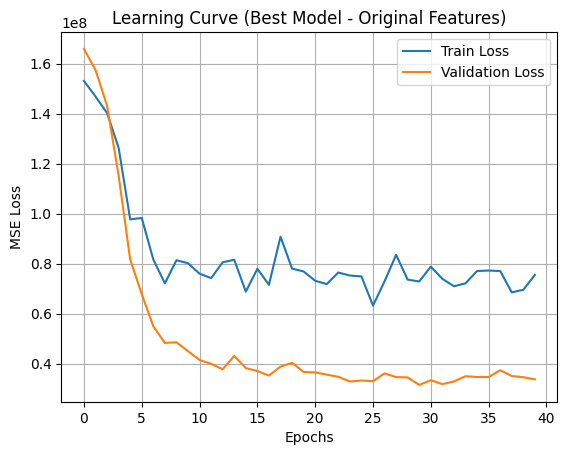

In [39]:
# Custom callback to print every N epochs
class PrintEveryN(tf.keras.callbacks.Callback):
    def __init__(self, N):
        super(PrintEveryN, self).__init__()
        self.N = N

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.N == 0:
            print(f"Epoch {epoch + 1}: loss = {logs['loss']:.4f}, val_loss = {logs['val_loss']:.4f}, mae = {logs['mae']:.2f}, val_mae = {logs['val_mae']:.2f}")

# Hyperparameter grid
learning_rates = [0.001, 0.0005]
dropout_rates = [0.3, 0.4]
l2_regs = [0.001, 0.0001]
batch_sizes = [8, 16]
epochs = 200
patience = 10
print_every_n = 50

# For tracking best model
best_val_loss = float('inf')
best_model = None
best_history = None
best_config = {}

# Iterate over all combinations
for lr in learning_rates:
    for dr in dropout_rates:
        for reg in l2_regs:
            for bs in batch_sizes:
                print(f"\n🔧 Training with lr={lr}, dropout={dr}, l2={reg}, batch_size={bs}")
                
                model = Sequential([
                    Dense(512, activation='relu', input_shape=(X_train_scaled_df.shape[1],), kernel_regularizer=l2(reg)),
                    Dropout(dr),
                    Dense(128, activation='relu', kernel_regularizer=l2(reg)),
                    Dropout(dr),
                    Dense(64, activation='relu', kernel_regularizer=l2(reg)),
                    Dropout(dr),
                    Dense(1)
                ])

                optimizer = Adam(learning_rate=lr)
                model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

                early_stop = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
                print_callback = PrintEveryN(print_every_n)

                history = model.fit(
                    X_train_scaled_df, y_train,
                    validation_data=(X_val_scaled_df, y_val),
                    epochs=epochs,
                    batch_size=bs,
                    callbacks=[early_stop, print_callback],
                    verbose=0
                )

                val_loss = min(history.history['val_loss'])
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_model = model
                    best_history = history
                    best_config = {
                        "learning_rate": lr,
                        "dropout_rate": dr,
                        "l2_reg": reg,
                        "batch_size": bs
                    }

# Predict and evaluate
val_preds = best_model.predict(X_val_scaled_df)
test_preds = best_model.predict(X_test_scaled_df)

print("\n✅ Best Hyperparameters:")
for k, v in best_config.items():
    print(f"{k}: {v}")

print("\n📊 Best Model (Validation):")
print(f"MAE: {mean_absolute_error(y_val, val_preds):.4f}")
print(f"MSE: {mean_squared_error(y_val, val_preds):.4f}")
print(f"R² : {r2_score(y_val, val_preds):.4f}")

print("\n📊 Best Model (Test):")
print(f"MAE: {mean_absolute_error(y_test, test_preds):.4f}")
print(f"MSE: {mean_squared_error(y_test, test_preds):.4f}")
print(f"R² : {r2_score(y_test, test_preds):.4f}")

# Plot learning curves
plt.plot(best_history.history['loss'], label='Train Loss')
plt.plot(best_history.history['val_loss'], label='Validation Loss')
plt.title("Learning Curve (Best Model - Original Features)")
plt.xlabel("Epochs")
plt.ylabel("MSE Loss")
plt.legend()
plt.grid(True)
plt.show()

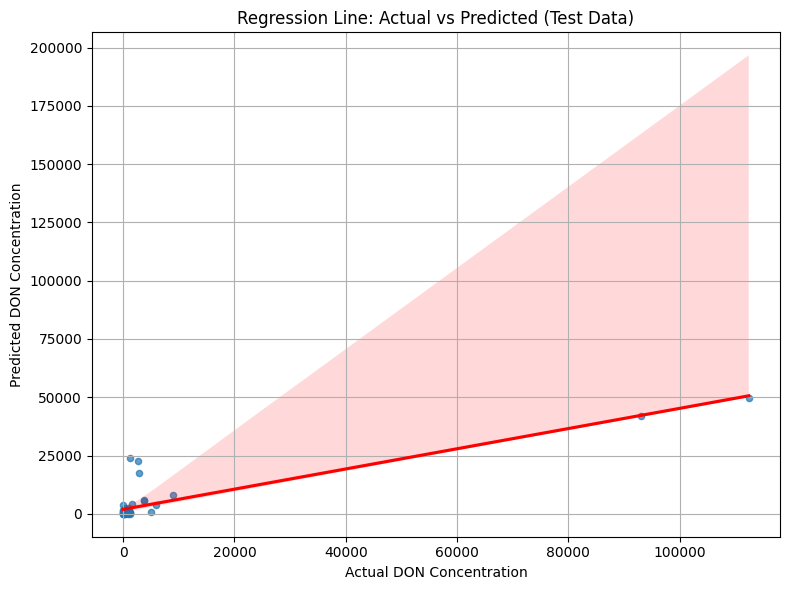

In [40]:
plt.figure(figsize=(8, 6))
sns.regplot(x=y_test, y=test_preds.flatten(), scatter_kws={"s": 20, "alpha": 0.7}, line_kws={"color": "red"})
plt.xlabel("Actual DON Concentration")
plt.ylabel("Predicted DON Concentration")
plt.title("Regression Line: Actual vs Predicted (Test Data)")
plt.grid(True)
plt.tight_layout()
plt.show()

## with PCA


🔍 Training with lr=0.001, dropout=0.2, batch_size=8
Epoch 50: loss = 120581840.0000, val_loss = 109780728.0000, mae = 3410.18, val_mae = 3477.96
Epoch 100: loss = 81740800.0000, val_loss = 67511616.0000, mae = 3065.06, val_mae = 3075.66
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step

🔍 Training with lr=0.001, dropout=0.2, batch_size=16
Epoch 50: loss = 122136680.0000, val_loss = 129367616.0000, mae = 3148.98, val_mae = 3566.13
Epoch 100: loss = 90213456.0000, val_loss = 79340000.0000, mae = 3274.50, val_mae = 3226.82
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

🔍 Training with lr=0.001, dropout=0.3, batch_size=8
Epoch 50: loss = 131000240.0000, val_loss = 126425784.0000, mae = 3231.76, val_mae = 3511.51
Epoch 100: loss = 108283536.0000, val_loss = 81182136.0000, mae = 3278.96, val_mae = 3115.87
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step

🔍 Training with lr=0.001, dropout=0.3, batch_size=16
Epoch 50: loss = 127644768.0000, val_loss = 135392608.0000, mae = 3171.84, val_mae = 3572.19
Epoch 100: loss = 99961

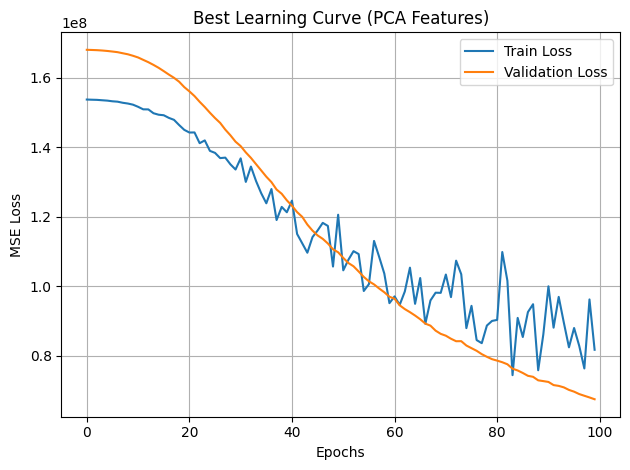

In [41]:
# Define hyperparameters for grid search
learning_rates = [0.001, 0.0005]
dropout_rates = [0.2, 0.3]
batch_sizes = [8, 16]
best_val_mae = float('inf')
best_model = None
best_history = None
best_params = {}

# Custom callback to print every N epochs
class PrintEveryN(tf.keras.callbacks.Callback):
    def __init__(self, N):
        super(PrintEveryN, self).__init__()
        self.N = N

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.N == 0:
            print(f"Epoch {epoch + 1}: loss = {logs['loss']:.4f}, val_loss = {logs['val_loss']:.4f}, mae = {logs['mae']:.2f}, val_mae = {logs['val_mae']:.2f}")

# Grid search
for lr in learning_rates:
    for dropout in dropout_rates:
        for batch_size in batch_sizes:
            print(f"\n🔍 Training with lr={lr}, dropout={dropout}, batch_size={batch_size}")

            model = Sequential([
                Dense(64, activation='relu', input_shape=(X_train_pca.shape[1],)),
                Dropout(dropout),
                Dense(8, activation='relu'),
                Dropout(dropout),
                Dense(1)
            ])

            optimizer = Adam(learning_rate=lr)
            model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

            early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
            print_callback = PrintEveryN(50)

            history = model.fit(
                X_train_pca, y_train,
                validation_data=(X_val_pca, y_val),
                epochs=100,
                batch_size=batch_size,
                callbacks=[early_stop, print_callback],
                verbose=0
            )

            val_preds = model.predict(X_val_pca)
            val_mae = mean_absolute_error(y_val, val_preds)

            if val_mae < best_val_mae:
                best_val_mae = val_mae
                best_model = model
                best_history = history
                best_params = {
                    'learning_rate': lr,
                    'dropout_rate': dropout,
                    'batch_size': batch_size
                }

# Save the best model
best_model.save('best_model.h5')  # Save in HDF5 format

# Evaluate the best model
test_preds = best_model.predict(X_test_pca)
val_preds = best_model.predict(X_val_pca)

val_results = {
    "MAE": mean_absolute_error(y_val, val_preds),
    "MSE": mean_squared_error(y_val, val_preds),
    "R2": r2_score(y_val, val_preds)
}

test_results = {
    "MAE": mean_absolute_error(y_test, test_preds),
    "MSE": mean_squared_error(y_test, test_preds),
    "R2": r2_score(y_test, test_preds)
}

# Plot learning curves of best model
plt.plot(best_history.history['loss'], label='Train Loss')
plt.plot(best_history.history['val_loss'], label='Validation Loss')
plt.title("Best Learning Curve (PCA Features)")
plt.xlabel("Epochs")
plt.ylabel("MSE Loss")
plt.legend()
plt.grid()
plt.tight_layout()

# Print best parameters and results
print("Best Parameters:", best_params)
print("Validation Results:", val_results)
print("Test Results:", test_results)

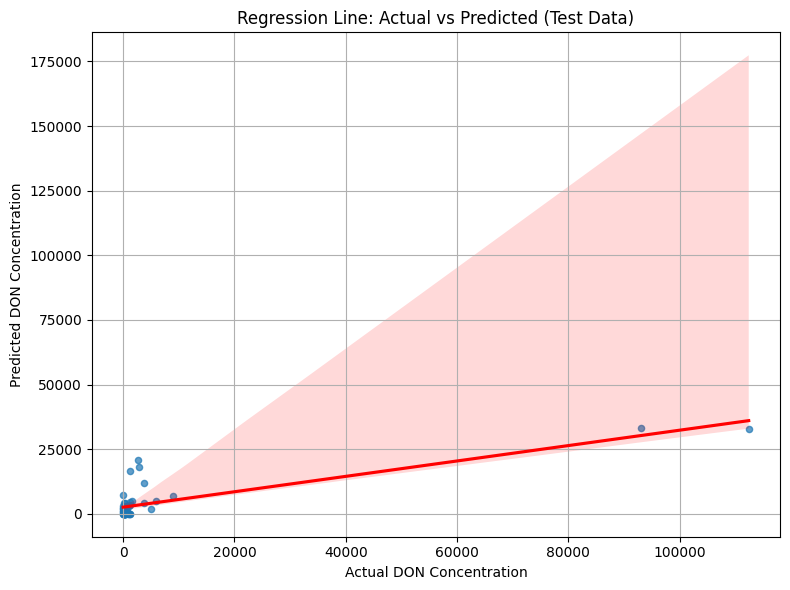

In [42]:
plt.figure(figsize=(8, 6))
sns.regplot(x=y_test, y=test_preds.flatten(), scatter_kws={"s": 20, "alpha": 0.7}, line_kws={"color": "red"})
plt.xlabel("Actual DON Concentration")
plt.ylabel("Predicted DON Concentration")
plt.title("Regression Line: Actual vs Predicted (Test Data)")
plt.grid(True)
plt.tight_layout()
plt.show()

# Final Train with LGBM and NN

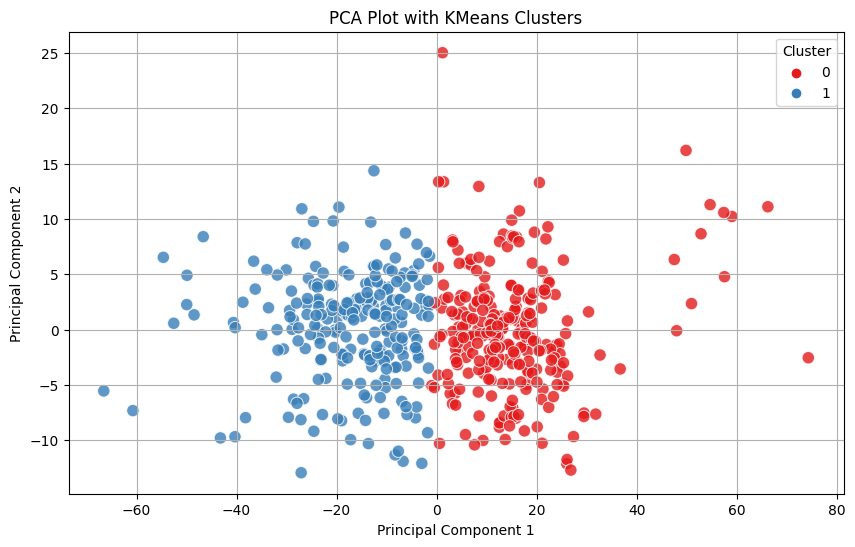

In [22]:
# Assume 'vomitoxin_ppb' is the target
X = train_df.drop('vomitoxin_ppb', axis=1)
y = train_df['vomitoxin_ppb']

# Standardize features before PCA
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 1: PCA to 2 components
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled)

# Step 2: KMeans clustering on PCA output
kmeans = KMeans(n_clusters=2, random_state=42)
clusters = kmeans.fit_predict(X_pca)

# Step 3: Convert PCA data to DataFrame and add Cluster column
X_pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
X_pca_df['Cluster'] = clusters

# Plot the PCA components with clusters as hue
plt.figure(figsize=(10, 6))
sns.scatterplot(data=X_pca_df, x='PC1', y='PC2', hue='Cluster', palette='Set1', s=80, alpha=0.8)

plt.title('PCA Plot with KMeans Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 4: Train-test split (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(
    X_pca_df, y, test_size=0.3, random_state=42
)

In [21]:
X_pca_df.head()

,PC1,PC2,Cluster
0,-14.500833,-2.182180,1
1,-14.395066,-2.283314,1
2,-30.073821,5.393228,1
3,4.494611,-1.838732,0
4,12.836440,1.221093,0


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 238
[LightGBM] [Info] Number of data points in the train set: 350, number of used features: 3
[LightGBM] [Info] Start training from score 3107.722857
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

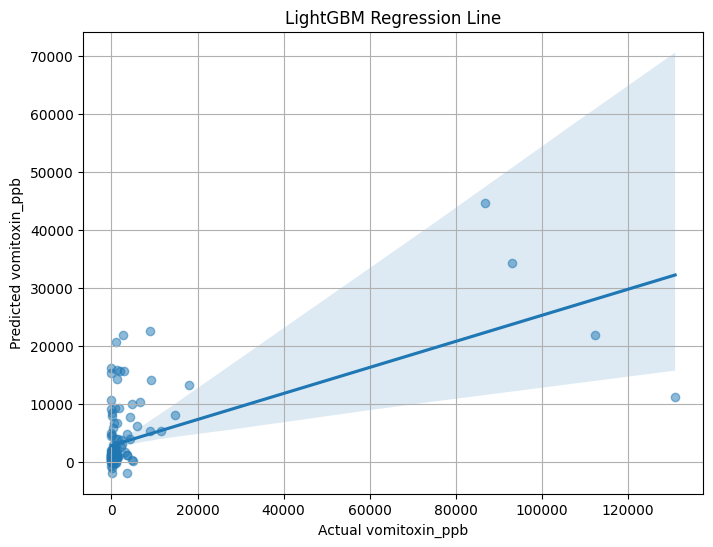

In [19]:
# Train LightGBM
lgb_model = LGBMRegressor(random_state=42)
lgb_model.fit(X_train, y_train)

# Predictions
y_pred = lgb_model.predict(X_test)

# Metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"📊 LightGBM - MSE: {mse:.2f}, R²: {r2:.2f}")

# Regression Plot
plt.figure(figsize=(8, 6))
sns.regplot(x=y_test, y=y_pred, scatter_kws={'alpha':0.5})
plt.xlabel('Actual vomitoxin_ppb')
plt.ylabel('Predicted vomitoxin_ppb')
plt.title('LightGBM Regression Line')
plt.grid(True)
plt.show()

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
📊 Neural Network - MSE: 275170298.38, R²: 0.08


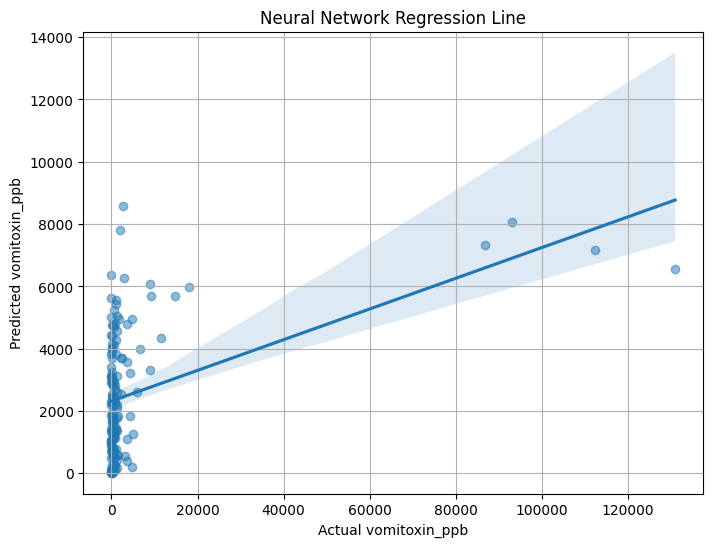

In [20]:
# Standardize NN input
scaler_nn = StandardScaler()
X_train_scaled = scaler_nn.fit_transform(X_train)
X_test_scaled = scaler_nn.transform(X_test)

# Define Neural Network
dropout = 0.3
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dropout(dropout),
    Dense(8, activation='relu'),
    Dropout(dropout),
    Dense(1)  # Output layer
])

# Compile and train
model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
model.fit(X_train_scaled, y_train, epochs=100, batch_size=16, verbose=0)

# Predict and evaluate
y_pred_nn = model.predict(X_test_scaled).flatten()

mse_nn = mean_squared_error(y_test, y_pred_nn)
r2_nn = r2_score(y_test, y_pred_nn)
print(f"📊 Neural Network - MSE: {mse_nn:.2f}, R²: {r2_nn:.2f}")

# Regression Plot
plt.figure(figsize=(8, 6))
sns.regplot(x=y_test, y=y_pred_nn, scatter_kws={'alpha':0.5})
plt.xlabel('Actual vomitoxin_ppb')
plt.ylabel('Predicted vomitoxin_ppb')
plt.title('Neural Network Regression Line')
plt.grid(True)
plt.show()

# Auto ML

In [25]:
!pip install h2o

In [26]:
import h2o
from h2o.automl import H2OAutoML
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Assume 'X_pca' is your PCA-reduced data (2 components), and 'clusters' is from KMeans
x_pca_df = pd.DataFrame(X_pca, columns=['PCA1', 'PCA2'])
x_pca_df['Cluster'] = clusters
x_pca_df['vomitoxin_ppb'] = train_df['vomitoxin_ppb'].values  # Add target

# Train-test split
train_data, test_data = train_test_split(x_pca_df, test_size=0.3, random_state=42)

# Start H2O
h2o.init()

# Convert to H2OFrame
train_h2o = h2o.H2OFrame(train_data)
test_h2o = h2o.H2OFrame(test_data)

# Train AutoML
aml = H2OAutoML(max_runtime_secs=120, seed=42)
aml.train(x=['PCA1', 'PCA2', 'Cluster'], y='vomitoxin_ppb', training_frame=train_h2o)

# View leaderboard
lb = aml.leaderboard
print(lb.head())

# Predictions
preds = aml.leader.predict(test_h2o).as_data_frame().values.flatten()
y_true = test_data['vomitoxin_ppb'].values

# Metrics
print("📊 Evaluation Metrics:")
print(f"MAE: {mean_absolute_error(y_true, preds):.4f}")
print(f"MSE: {mean_squared_error(y_true, preds):.4f}")
print(f"R²: {r2_score(y_true, preds):.4f}")

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.25" 2024-10-15; OpenJDK Runtime Environment (build 11.0.25+9-post-Ubuntu-1ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.25+9-post-Ubuntu-1ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpc87u_3k5
  JVM stdout: /tmp/tmpc87u_3k5/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpc87u_3k5/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.
Please download and install the latest version from: https://h2o-release.s3.amazonaws.com/h2o/latest_stable.html


H2O_cluster_uptime:,04 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.6
H2O_cluster_version_age:,4 months and 12 days
H2O_cluster_name:,H2O_from_python_unknownUser_fxdrdg
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,7.500 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%
model_id                                            rmse          mse      mae    rmsle    mean_residual_deviance
XGBoost_grid_1_AutoML_1_20250314_152648_model_9  8731.54  7.62398e+07  3630.17      nan               7.62398e+07
XGBoost_2_AutoML_1_20250314_152648               8851.41  7.83475e+07  3712.29      nan               7.83475e+07
GBM_grid_1_AutoML_1_20250314_152648_model_4      8853.38  7.83824e+07  3458.26      nan               7.83824e+07
GBM_grid_1_AutoML_1_20250314_152648_model_13     8948.81  8.00812e+07  3578.6       nan               8.00812e+07
GBM_grid_1_AutoML_1_20250314_152648_model_28     8948.9   8.00829e+07  3325.39      nan               8.00829e+07
XGBoost_grid_1_AutoML_1_2025031

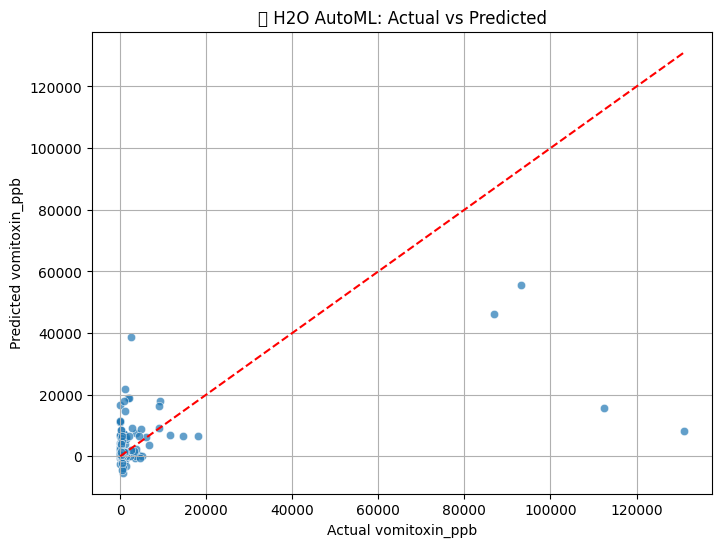

In [28]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_true, y=preds, alpha=0.7)
plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--')
plt.xlabel("Actual vomitoxin_ppb")
plt.ylabel("Predicted vomitoxin_ppb")
plt.title("H2O AutoML: Actual vs Predicted")
plt.grid(True)
plt.show()